# EDA de los datos para Obesity


## Conclusiones:

1. Las variables numéricas tienen una distribución que tiende a ser normal, sin importar que se trate de toda la muestra o simplemente los hombres o las mujeres
2. El dataset está relativamente balanceado con respecto al género: 52,82% son mujeres y 47,18% son hombres
3. La mayoría de personas tienen los valores de los indicadores normales, por lo tanto tienen un riesgo nulo o bajo de padecer obesidad y ENT
4. Hay una alta correlación entre el peso y el contorno de cintura y los indicadores calculados
5. La acumulación de grasa abdominal, principalmente medida por el contorno de cintura, está extreñamente relacionada con índices altos de sobrepeso/obesidad y factores de riesgo
6. A medida que las personas envejecen, aumentan las posibilidades de padecer sobrepeso/obesidad
7. En general, los hombres sufren más frecuentemente de obesidad

In [1]:
# Librerías

from pathlib import Path

import pandas as pd
import numpy as np

# EDA Reporting
from ydata_profiling import ProfileReport

import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import altair as alt # importar altair con el alias alt

# Funciones propias
import data_common_functions as dcf
import char_common_functions as ccf

In [2]:
def divide_by_gender(df, val):

    query = f"gender == '{val}'"

    df = df.query(query)
        
    return df

In [3]:
# Genera un reporte EDA para un dataframe

def profiling_report(df, title):

    profile = ProfileReport(df, title=title)

    profile.to_file(f"{title}.html")

## Main

In [4]:
# Leemos el archivo
CURRENT_DIR = Path.cwd()

BASE_DIR = Path(CURRENT_DIR).parent

df_obesity = dcf.read_file(f"{BASE_DIR}/data/out/obesity.parquet")

df_obesity

,age,age_range,gender,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_bmi_txt,obesity_cc,obesity_cc_txt,obesity_rcc,obesity_rcc_txt,obesity_ict,obesity_ict_txt,risk_factors
1,47.0,46-55,male,187.1980,156.630,138.5062,142.1892,1,44.696399,0.974098,0.739891,3,3-Obesidad,1,1-Alto,1,1-Medio,3,3-Obesidad,4
2,50.0,46-55,male,180.5940,98.064,98.3996,109.9058,1,30.067891,0.895309,0.544866,3,3-Obesidad,1,1-Alto,0,0-Bajo,2,2-Sobrepeso,3
3,28.0,26-35,male,182.7022,89.211,97.0026,107.0102,1,26.725809,0.906480,0.530933,2,2-Sobrepeso,1,1-Alto,0,0-Bajo,2,2-Sobrepeso,3
4,52.0,46-55,male,185.9026,113.273,105.9942,111.0996,1,32.775964,0.954047,0.570160,3,3-Obesidad,1,1-Alto,1,1-Medio,2,2-Sobrepeso,4
5,50.0,46-55,male,183.1086,108.279,104.0892,112.3950,1,32.294365,0.926102,0.568456,3,3-Obesidad,1,1-Alto,0,0-Bajo,2,2-Sobrepeso,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4460,35.0,26-35,female,152.8064,49.259,61.5950,93.0910,0,21.096116,0.661664,0.403092,1,1-Normal,0,0-Bajo,0,0-Bajo,0,0-Delgado,0
4461,40.0,36-45,female,168.6052,67.646,73.8124,100.4062,0,23.795794,0.735138,0.437782,1,1-Normal,0,0-Bajo,0,0-Bajo,1,1-Normal,0
4462,23.0,17-25,female,168.5036,73.775,78.0034,109.7026,0,25.983093,0.711044,0.462918,2,2-Sobrepeso,0,0-Bajo,0,0-Bajo,1,1-Normal,1
4463,24.0,17-25,male,170.5102,65.149,75.7936,97.7900,1,22.408203,0.775065,0.444511,1,1-Normal,0,0-Bajo,0,0-Bajo,1,1-Normal,0


In [5]:
df_obesity.describe()

,age,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_cc,obesity_rcc,obesity_ict,risk_factors
count,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000,4430.000000
mean,37.764312,170.937562,75.205328,84.701265,103.513457,0.471783,25.608337,0.816921,0.495404,1.598871,0.345824,0.272009,1.403837,1.383521
std,12.786156,10.387864,18.419132,13.362246,10.273928,0.499260,5.288433,0.085733,0.071842,0.777331,0.475690,0.589520,0.765085,1.525385
min,17.500000,124.790200,37.332420,55.702200,80.010000,0.000000,15.263630,0.583295,0.334210,0.000000,0.000000,0.000000,0.000000,0.000000
25%,26.400000,163.322000,61.957380,75.006200,96.697800,0.000000,21.940406,0.752614,0.445829,1.000000,0.000000,0.000000,1.000000,0.000000
50%,37.000000,170.408600,72.186000,83.007200,101.904800,0.000000,24.498035,0.820929,0.482352,1.000000,0.000000,0.000000,1.000000,1.000000
75%,48.000000,177.901600,84.898000,92.278200,108.102400,1.000000,27.973753,0.876377,0.530471,2.000000,1.000000,0.000000,2.000000,3.000000
max,79.000000,218.287600,181.600000,170.205400,183.388000,1.000000,57.180160,1.153405,0.970878,3.000000,1.000000,2.000000,3.000000,4.000000


In [6]:
# Variables categóricas (tipo object)

df_obesity.select_dtypes(include=['object']).describe()

,age_range,gender,obesity_bmi_txt,obesity_cc_txt,obesity_rcc_txt,obesity_ict_txt
count,4430,4430,4430,4430,4430,4430
unique,6,2,4,2,3,4
top,26-35,female,1-Normal,0-Bajo,0-Bajo,1-Normal
freq,1068,2340,2313,2898,3556,2399


In [7]:
df_obesity.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4430 entries, 1 to 4464
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   age                     4430 non-null   float64
 1   age_range               4430 non-null   object 
 2   gender                  4430 non-null   object 
 3   height                  4430 non-null   float64
 4   weight                  4430 non-null   float64
 5   waist_circum_preferred  4430 non-null   float64
 6   hip_circum              4430 non-null   float64
 7   gender_bin              4430 non-null   int64  
 8   bmi                     4430 non-null   float64
 9   rcc                     4430 non-null   float64
 10  ict                     4430 non-null   float64
 11  obesity_bmi             4430 non-null   int64  
 12  obesity_bmi_txt         4430 non-null   object 
 13  obesity_cc              4430 non-null   int64  
 14  obesity_cc_txt          4430 non-null   

## EDA con Profiling Report

In [8]:
#profiling_report(df_obesity, 'Profile Report Obesity')

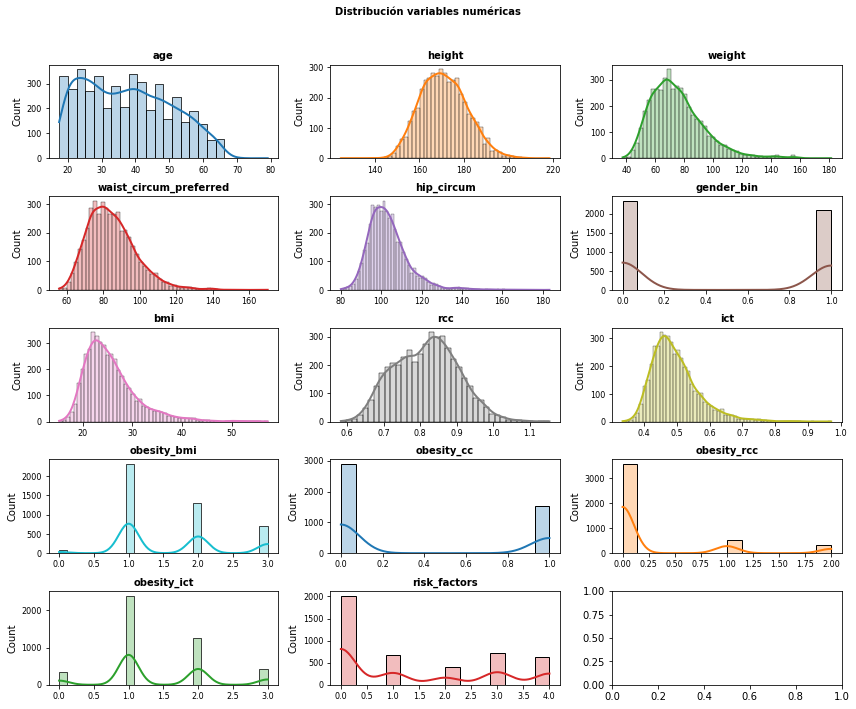

In [9]:
ccf.num_var_distribution(df_obesity)

## Datos según el género

In [10]:
df_eda = df_obesity.copy()

In [11]:
df_eda_f = divide_by_gender(df_eda, 'female')
df_eda_f.describe()

,age,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_cc,obesity_rcc,obesity_ict,risk_factors
count,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.0,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000,2340.000000
mean,37.979487,164.687163,68.229479,79.904503,104.268672,0.0,25.120005,0.764546,0.485566,1.505128,0.385897,0.391453,1.443162,1.455128
std,12.805037,7.609930,16.642426,12.974837,11.280108,0.0,5.724213,0.071123,0.077974,0.788692,0.486911,0.686842,0.865332,1.623930
min,18.000000,124.790200,37.332420,55.702200,80.010000,0.0,15.263630,0.583295,0.334210,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,159.512000,56.849880,71.170800,96.697800,0.0,21.252199,0.712801,0.431441,1.000000,0.000000,0.000000,1.000000,0.000000
50%,37.000000,164.388800,64.676840,76.758800,102.311200,0.0,23.513015,0.757958,0.466355,1.000000,0.000000,0.000000,1.000000,1.000000
75%,48.000000,169.595800,75.365135,85.801200,109.296200,0.0,27.374036,0.805779,0.519677,2.000000,1.000000,1.000000,2.000000,3.000000
max,69.000000,194.792600,156.630000,149.809200,173.812200,0.0,57.180160,1.153405,0.875594,3.000000,1.000000,2.000000,3.000000,4.000000


In [12]:
df_eda_m = divide_by_gender(df_eda, 'male')
df_eda_m.describe()

,age,height,weight,waist_circum_preferred,hip_circum,gender_bin,bmi,rcc,ict,obesity_bmi,obesity_cc,obesity_rcc,obesity_ict,risk_factors
count,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.0,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000,2090.000000
mean,37.523397,177.935617,83.015607,90.071803,102.667906,1.0,26.155082,0.875561,0.506419,1.703828,0.300957,0.138278,1.359809,1.303349
std,12.763741,8.436921,17.135835,11.637414,8.942443,0.0,4.694816,0.058367,0.062493,0.750831,0.458784,0.418023,0.631631,1.402944
min,17.500000,131.495800,45.854000,61.899800,81.102200,1.0,16.137889,0.622796,0.358646,0.000000,0.000000,0.000000,0.000000,0.000000
25%,26.000000,172.212000,70.889830,82.194400,96.697800,1.0,22.894586,0.834306,0.462974,1.000000,0.000000,0.000000,1.000000,0.000000
50%,37.000000,177.546000,80.101490,88.290400,101.701600,1.0,25.503224,0.870376,0.497511,2.000000,0.000000,0.000000,1.000000,1.000000
75%,47.000000,183.311800,91.481000,95.707200,107.010200,1.0,28.305405,0.911671,0.536067,2.000000,1.000000,0.000000,2.000000,3.000000
max,79.000000,218.287600,181.600000,170.205400,183.388000,1.0,55.121673,1.130743,0.970878,3.000000,1.000000,2.000000,3.000000,4.000000


/home/diana/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


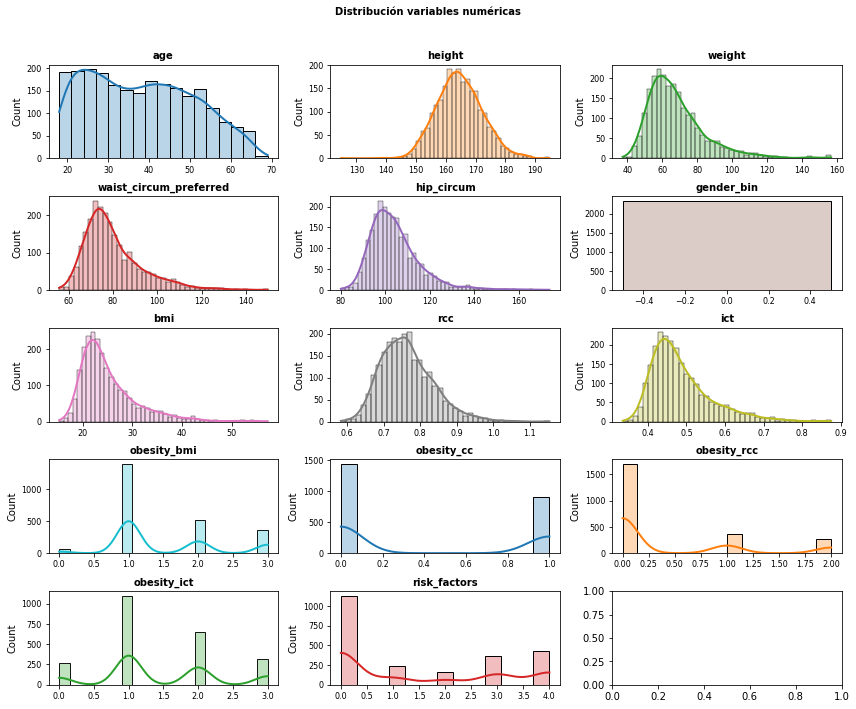

In [13]:
ccf.num_var_distribution(df_eda_f)

/home/diana/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


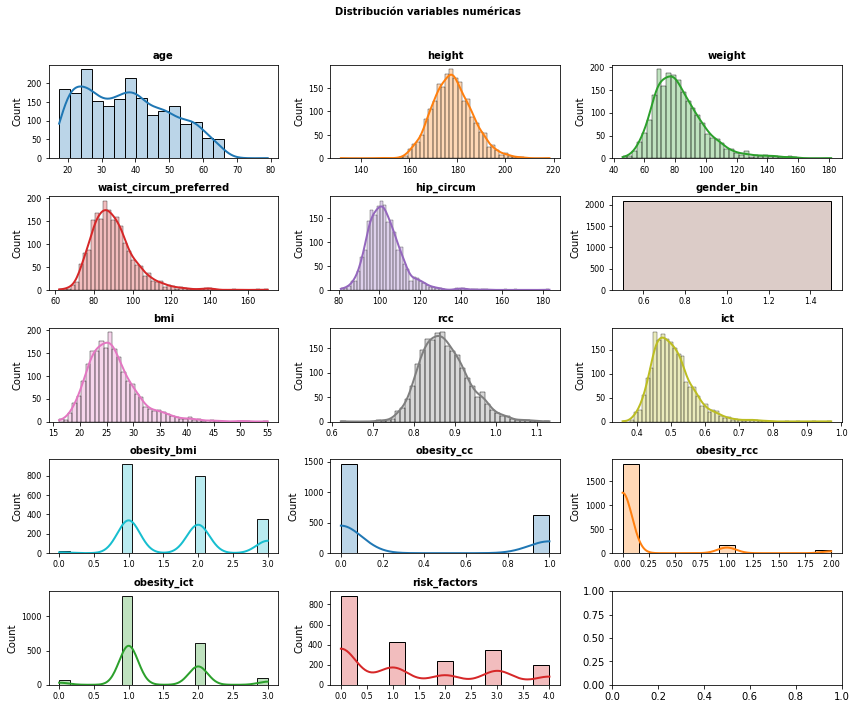

In [14]:
ccf.num_var_distribution(df_eda_m)

## Correlación entre los datos

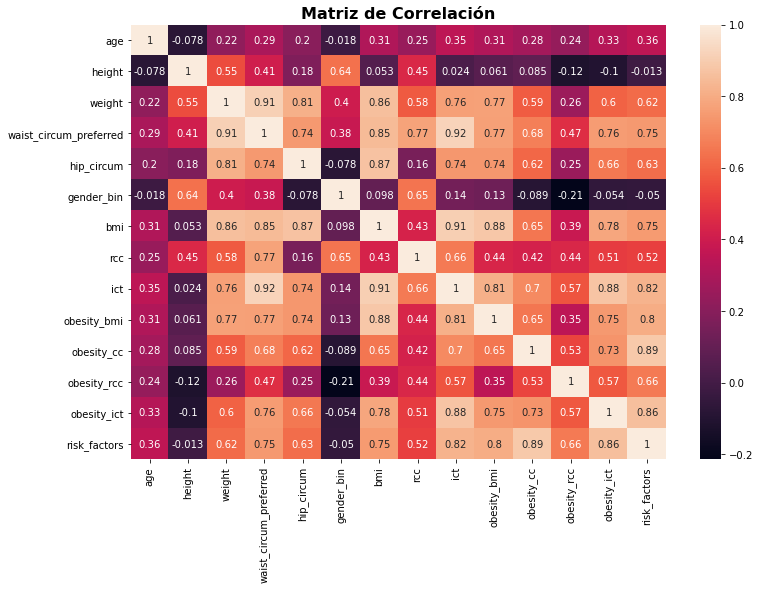

In [15]:
corr_df = df_eda.corr(method='pearson')

fig, ax = plt.subplots(figsize=(12, 8))
sns.heatmap(corr_df, annot=True)
ax.set_title('Matriz de Correlación', fontsize=16, weight='bold')
plt.show()

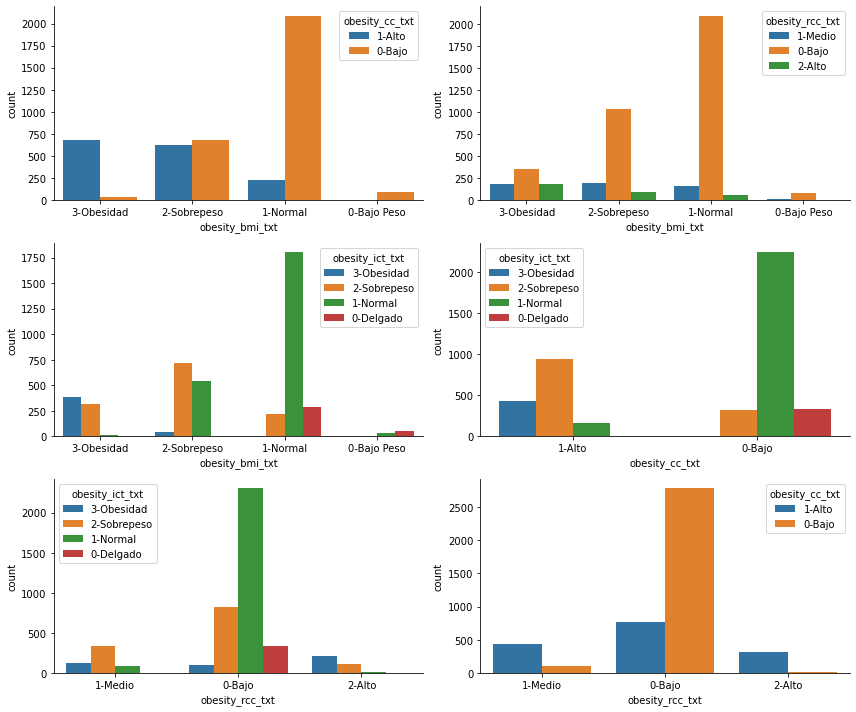

In [16]:
# Configurar el diseño de 3x2
plt.figure(figsize=(12, 10))  # Ajusta el tamaño de la figura según tus necesidades

# Gráfico 1
plt.subplot(3, 2, 1)
sns.despine()
sns.countplot(x='obesity_bmi_txt', hue='obesity_cc_txt', data=df_obesity)

# Gráfico 2
plt.subplot(3, 2, 2)
sns.despine()
sns.countplot(x='obesity_bmi_txt', hue='obesity_rcc_txt', data=df_obesity)

# Gráfico 3
plt.subplot(3, 2, 3)
sns.despine()
sns.countplot(x='obesity_bmi_txt', hue='obesity_ict_txt', data=df_obesity)

# Gráfico 4
plt.subplot(3, 2, 4)
sns.despine()
sns.countplot(x='obesity_cc_txt', hue='obesity_ict_txt', data=df_obesity)

# Gráfico 5
plt.subplot(3, 2, 5)
sns.despine()
sns.countplot(x='obesity_rcc_txt', hue='obesity_ict_txt', data=df_obesity)

# Gráfico 6
plt.subplot(3, 2, 6)
sns.despine()
sns.countplot(x='obesity_rcc_txt', hue='obesity_cc_txt', data=df_obesity)

# Ajustar el diseño y mostrar los gráficos
plt.tight_layout()
plt.show()


### Estudio weight

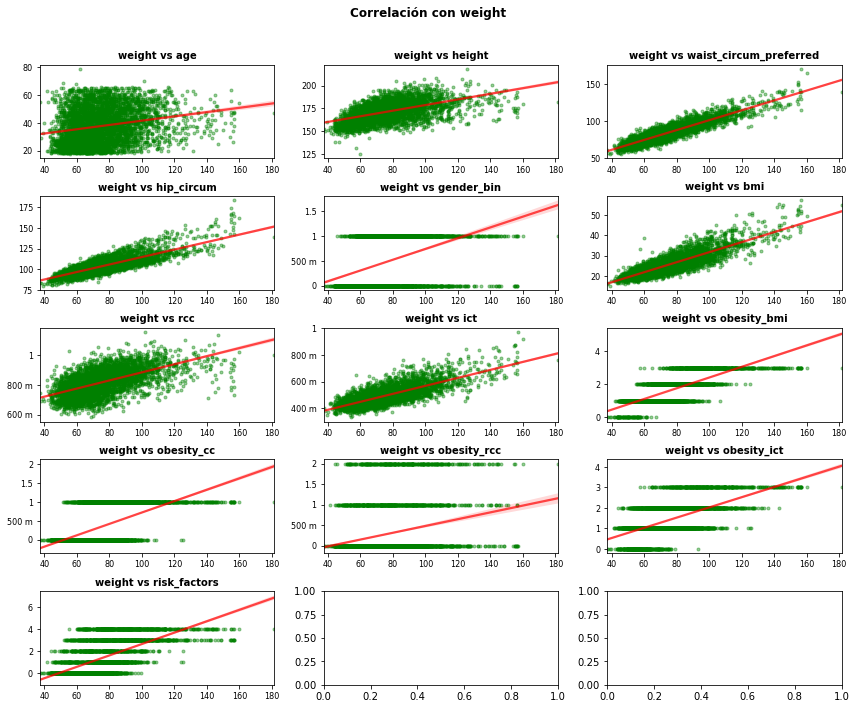

In [17]:
ccf.num_var_correl(df_obesity, 'weight')

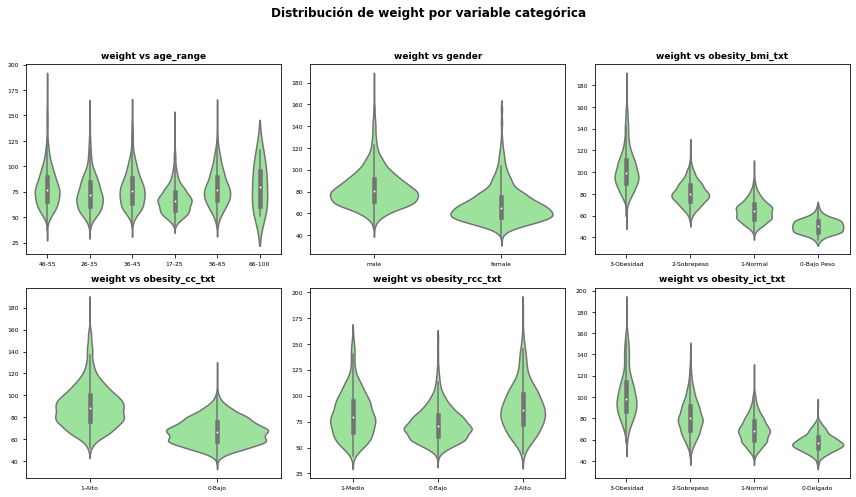

In [18]:
ccf.distribution_var_categ(df_obesity, 'weight')

## Estudio height

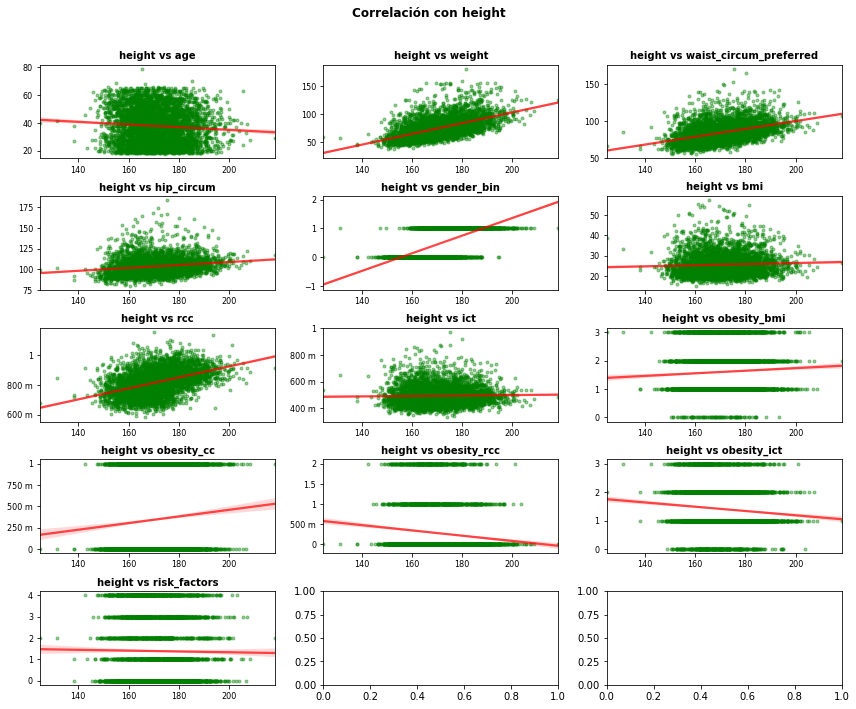

In [19]:
ccf.num_var_correl(df_obesity, 'height')

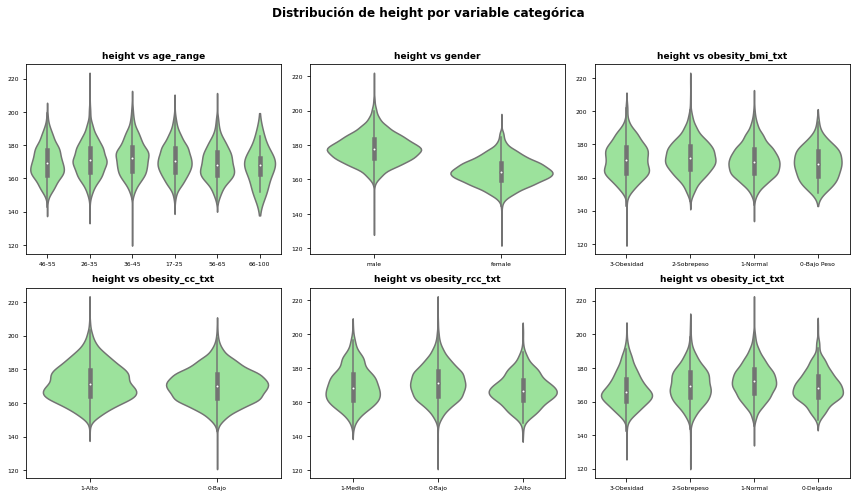

In [20]:
ccf.distribution_var_categ(df_obesity, 'height')

## Estudio waist_circum_preferred

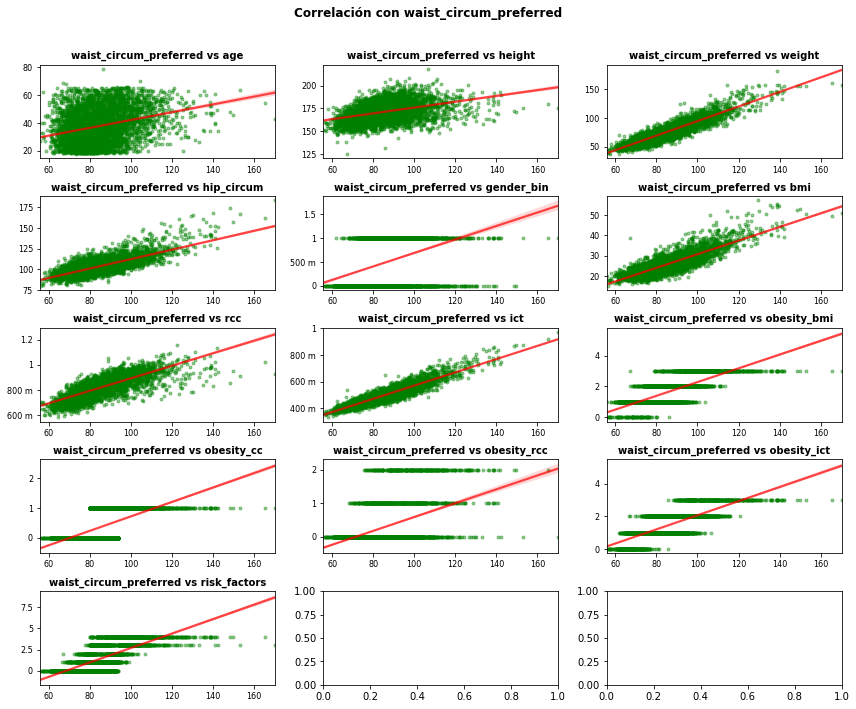

In [21]:
ccf.num_var_correl(df_obesity, 'waist_circum_preferred')

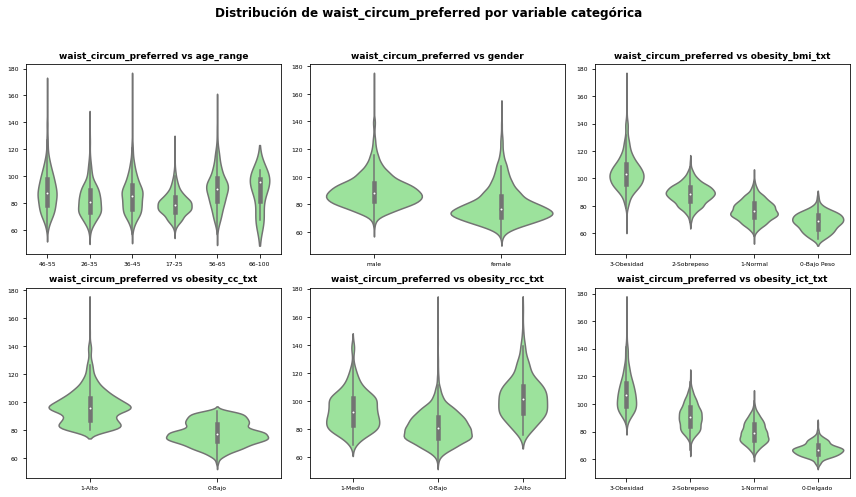

In [22]:
ccf.distribution_var_categ(df_obesity, 'waist_circum_preferred')

## Estudio hip_circum

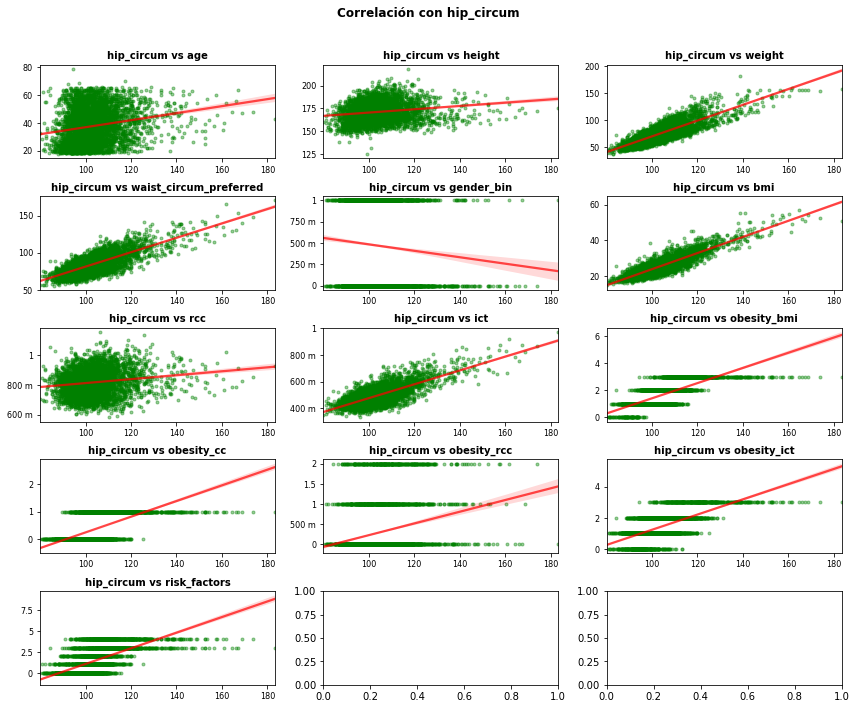

In [23]:
ccf.num_var_correl(df_obesity, 'hip_circum')

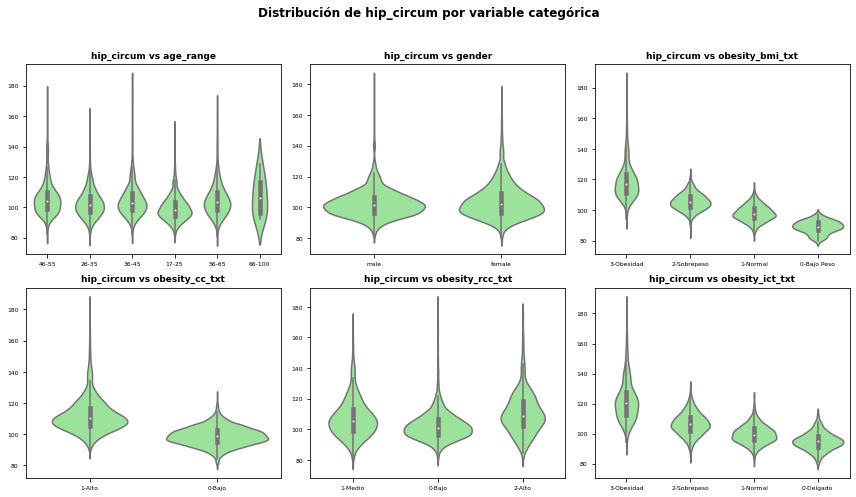

In [24]:
ccf.distribution_var_categ(df_obesity, 'hip_circum')

### Preguntas para conocer mejor los datos y cómo se relacionan

La idea es también determinar qué tan pertinentes son los datos escogidos.

1. Influencia de la edad y el género en la incidencia de sobrepeso y obesidad, qué tan relacionados están esos datos. Usaremos principalmente el BMI, pero podemos estudiar también los otros indicadores.
2. ¿Cómo se relacionan BMI,ICT, RCC y CC? ¿Cuándo hablar de sobrepeso y cuándo de obesidad? 
3. ¿Cuándo hablar de riesgo de sufrir ENT?
4. Pertinencia de los indicadores calculados: Cómo deberíamos interpretar los 3 indicadores para determinar si una persona corre el riesgo de padecer sobrepeso y obesidad

### Algunas conclusiones

1. Según el BMI, el sobrepeso y la obesidad son más frecuentes en los hombres (50% percentil > 25)
2. Sin embargo, según el ICT, sólo el 25% percentil sufren de sobrepeso u obesidad (obesity_ict >= 3), sin importar el género


## Estudio BMI

In [25]:
# Estudio BMI

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_bmi_txt:N'

title='Cantidad de Individuos según su rango de edad y grado de Obesidad según su BMI'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total


alt.VConcatChart(...)

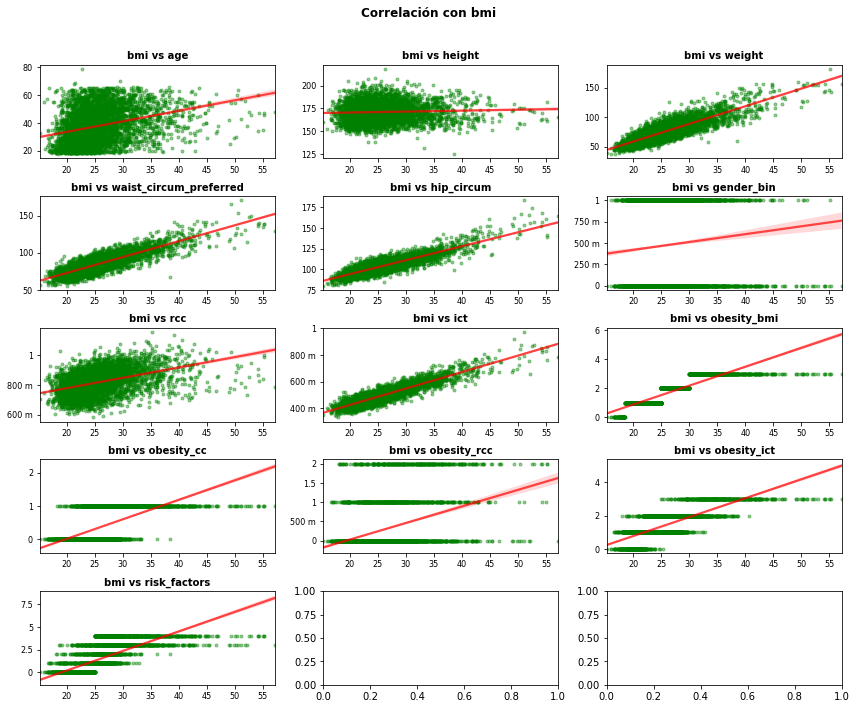

In [26]:
ccf.num_var_correl(df_obesity, 'bmi')

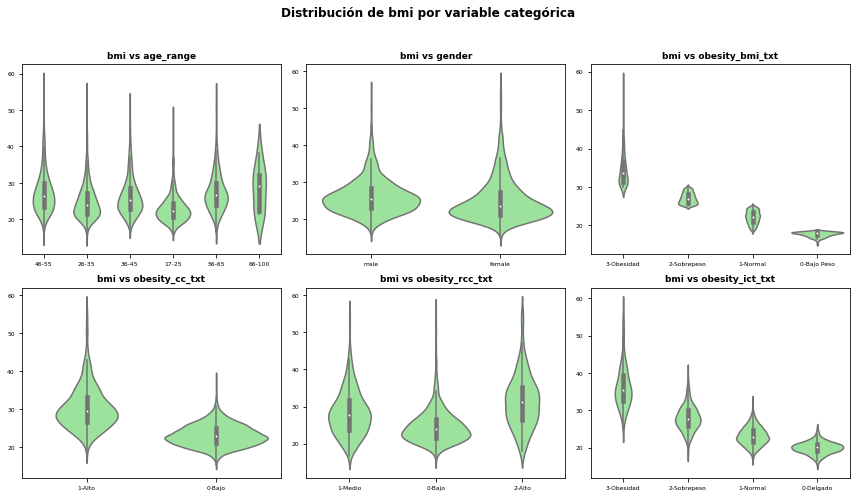

In [27]:
ccf.distribution_var_categ(df_obesity, 'bmi')

## Estudio ICT

In [28]:
# Estudio ICT

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_ict_txt:N'

title='Cantidad de Individuos según su rango de edad y grado de Obesidad según su ICT'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

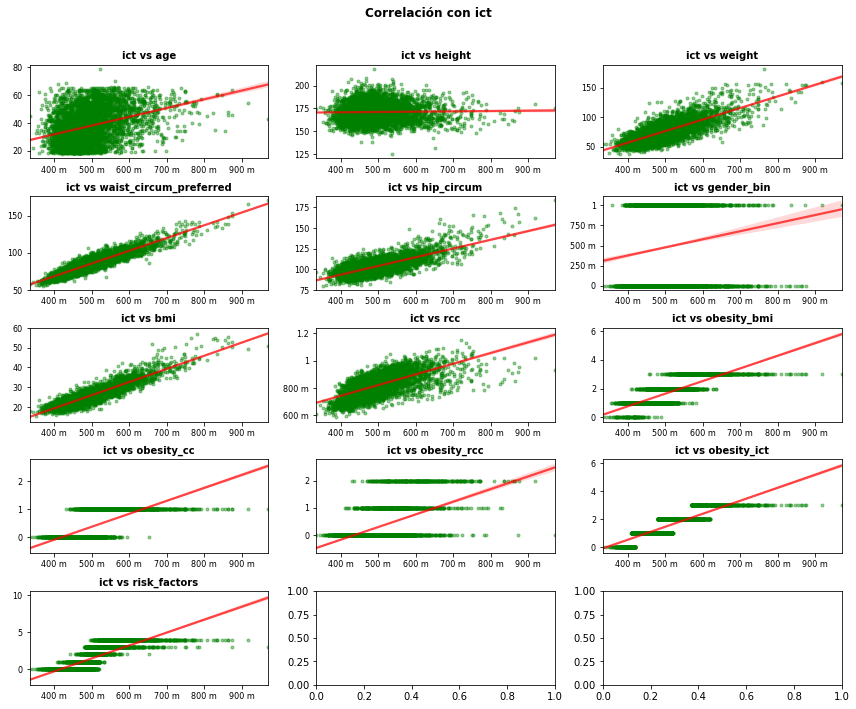

In [29]:
ccf.num_var_correl(df_obesity, 'ict')

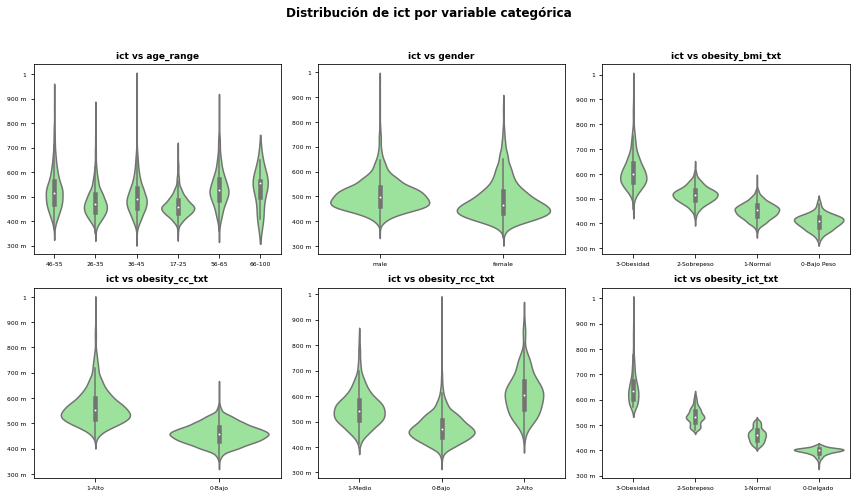

In [30]:
ccf.distribution_var_categ(df_obesity, 'ict')

## Estudio RCC

In [31]:
# Estudio RCC

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_rcc_txt:N'

title='Cantidad de Individuos según su rango de edad y riesgo de Obesidad según su RCC'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

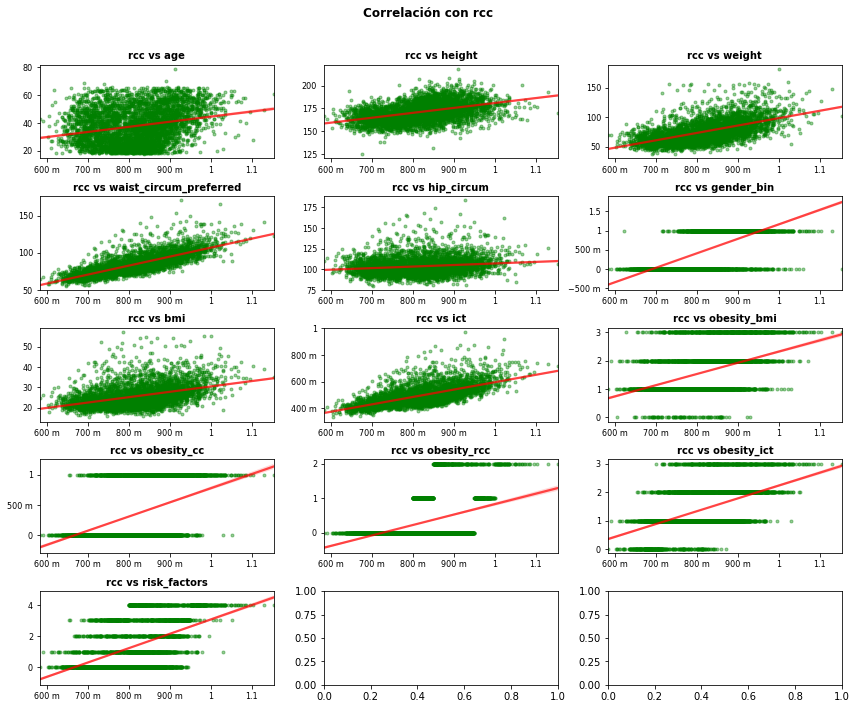

In [32]:
ccf.num_var_correl(df_obesity, 'rcc')

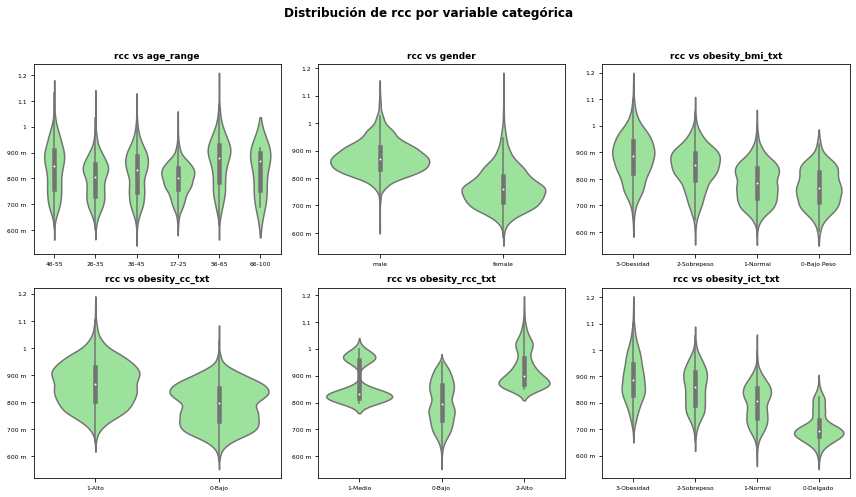

In [33]:
ccf.distribution_var_categ(df_obesity, 'rcc')

## Estudio CC

In [34]:
# Estudio CC

x = 'count(*):Q'
y = 'age_range:O'
detail = 'obesity_cc_txt:N'

title='Cantidad de Individuos según su rango de edad y riesgo de Obesidad según su CC'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

## Estudio factores de riesgo

In [35]:
# Estudio Obesidad y riesgo de ENT (calculado)

x = 'count(*):Q'
y = 'age_range:O'
detail = 'risk_factors:N'

title='Cantidad de Individuos según su rango de edad y cantidad de factores de riesgo'
title_f='Sólo Mujeres'
title_m='Sólo Hombres'

title_x = 'Total individuos'
title_y = 'Rangos de Edad'

char_todo = ccf.char_bars(df_eda, x, y, detail, title, title_x, title_y)
char_f = ccf.char_bars(df_eda_f, x, y, detail, title_f, title_x, title_y)
char_m = ccf.char_bars(df_eda_m, x, y, detail, title_m, title_x, title_y)

char_total = alt.vconcat(char_todo, char_f, char_m)

char_total

alt.VConcatChart(...)

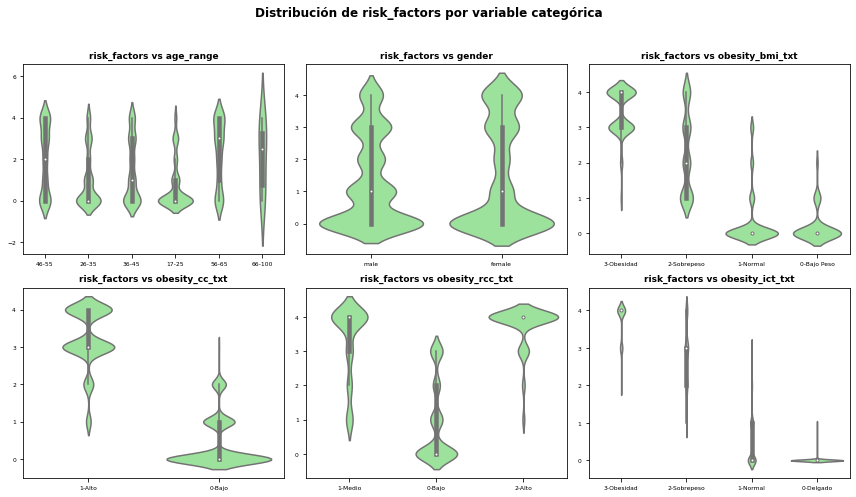

In [36]:
ccf.distribution_var_categ(df_obesity, 'risk_factors')